# Assignment 1:  Superpixels and Image Segmentation.

Name: Aniruddh Balram

UID:  119206416

Link to Google Drive : **View-only Link to Notebook Here (make sure it works)**

Please submit a PDF containing all outputs to gradescope by **October 5, 11:59pm**

----------------------------

In this assignment, you will learn about superpixels. You will first generate superpixels by clustering pixels via k-means. This will generate a superpixel map such as the following:

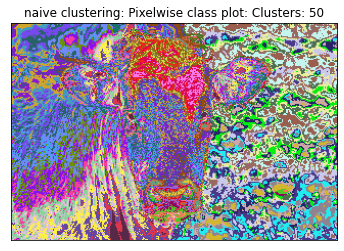

You will then implement a better superpixel algorithm: SLIC, which lets you generate superpixel maps like the following:

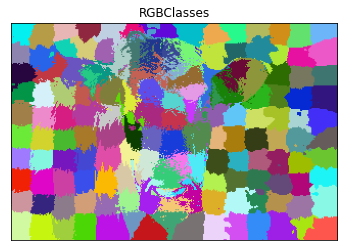

You will then build a segmentation network by training a deep neural network on your superpixels. This part is fairly open-ended, feel free to try any model you can think of (GNN, CNN, Transformer, etc.).

To give an example, for a CNN-based system that reformulates segmentation as superpixel image classification, there are basically three steps in the training stage:

1. Dilate and save each superpixel region from SLIC output into image of size 224X224, alongwith the ground truth segments label.
2. Build a couple of convolution layers to extract the deep features from each Superpixel patch image. Let the last layer be Fully connected layers.
3. Define the segmentation loss as multi-class classification loss and train a convolutional neural network based classifier.

Then, during inference, you would combine the classifier's predicted labels to form the whole input image's Superpixel segmentation results.

## Part 1: Superpixels

For this first part of the assignment, you will implement 2 superpixels methods: k-means pixel clustering, and SLIC.

### Data

First, we download the MSRC labeled imaged database.

In [1]:
!wget http://download.microsoft.com/download/A/1/1/A116CD80-5B79-407E-B5CE-3D5C6ED8B0D5/msrc_objcategimagedatabase_v1.zip
!unzip --qq msrc_objcategimagedatabase_v1.zip

--2023-10-06 05:22:11--  http://download.microsoft.com/download/A/1/1/A116CD80-5B79-407E-B5CE-3D5C6ED8B0D5/msrc_objcategimagedatabase_v1.zip
Resolving download.microsoft.com (download.microsoft.com)... 23.50.228.186, 2600:1408:20:c84::317f, 2600:1408:20:c9e::317f
Connecting to download.microsoft.com (download.microsoft.com)|23.50.228.186|:80... connected.
HTTP request sent, awaiting response... 302 Moved Temporarily
Location: https://download.microsoft.com/download/A/1/1/A116CD80-5B79-407E-B5CE-3D5C6ED8B0D5/msrc_objcategimagedatabase_v1.zip [following]
--2023-10-06 05:22:12--  https://download.microsoft.com/download/A/1/1/A116CD80-5B79-407E-B5CE-3D5C6ED8B0D5/msrc_objcategimagedatabase_v1.zip
Connecting to download.microsoft.com (download.microsoft.com)|23.50.228.186|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 44119839 (42M) [application/octet-stream]
Saving to: ‘msrc_objcategimagedatabase_v1.zip’

msrc_objcategimaged 100%[===================>]  42.08M  24.

For the first part of this assignment, we will only use the following images. We define the list below as `im_list`.

In [2]:
im_list = ['MSRC_ObjCategImageDatabase_v1/1_22_s.bmp',
           'MSRC_ObjCategImageDatabase_v1/1_27_s.bmp',
           'MSRC_ObjCategImageDatabase_v1/3_3_s.bmp',
           'MSRC_ObjCategImageDatabase_v1/3_6_s.bmp',
           'MSRC_ObjCategImageDatabase_v1/6_5_s.bmp',
           'MSRC_ObjCategImageDatabase_v1/7_19_s.bmp']

We provide the following functions as helpers for plotting your results. Please pay attention to their signatures and outputs.





In [3]:
#All important functions to plot
%matplotlib inline
import cv2
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as mpatches

def plot_image(im, title, xticks = [], yticks = [], isCv2 = True):
    """
    im :Image to plot
    title : Title of image
    xticks : List of tick values. Defaults to nothing
    yticks :List of tick values. Defaults to nothing
    cv2 :Is the image cv2 image? cv2 images are BGR instead of RGB. Default True
    """
    plt.figure()
    if isCv2:
        im = im[:,:,::-1]
    plt.imshow(im)
    plt.title(title)
    plt.xticks(xticks)
    plt.yticks(yticks)

def superpixel_plot(im,seg,title = "Superpixels"):
    """
    Given an image (nXmX3) and pixelwise class mat (nXm),
    1. Consider each class as a superpixel
    2. Calculate mean superpixel value for each class
    3. Replace the RGB value of each pixel in a class with the mean value

    Inputs:
    im: Input image
    seg: Segmentation map
    title: Title of the plot

    Output: None
    Creates a plot
    """
    clust = np.unique(seg)
    mapper_dict = {i: im[seg == i].mean(axis = 0)/255. for i in clust}

    seg_img =  np.zeros((seg.shape[0],seg.shape[1],3))
    for i in clust:
        seg_img[seg == i] = mapper_dict[i]

    plot_image(seg_img,title)

    return

def rgb_segment(seg,n = None,plot = True,title=None,legend = True,color = None):
    """
    Given a segmentation map, get the plot of the classes
    """
    clust = np.unique(seg)
    if n is None:
        n = len(clust)
    if color is None:
        cm = plt.cm.get_cmap('hsv',n+1)
        # mapper_dict = {i:np.array(cm(i/n)) for i in clust}
        mapper_dict = {i:np.random.rand(3,) for i in clust}
    #elif color == 'mean':
        #TODO..get the mean color of cluster center and assign that to mapper_dict

    seg_img =  np.zeros((seg.shape[0],seg.shape[1],3))
    for i in clust:
        seg_img[seg == i] = mapper_dict[i][:3]

    if plot:
        plot_image(seg_img,title = title)
    if legend:
        # get the colors of the values, according to the
        # colormap used by imshow
        patches = [ mpatches.Patch(color=mapper_dict[i], label=" : {l}".format(l=i) ) for i in range(n) ]
        # put those patched as legend-handles into the legend
        plt.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0. )
        plt.grid(True)
        plt.show()

    return seg_img

For example, the following code uses `plot_image` to plot the 6 images we are using for this assignment.

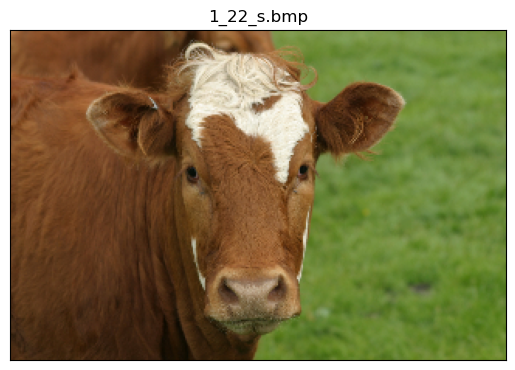

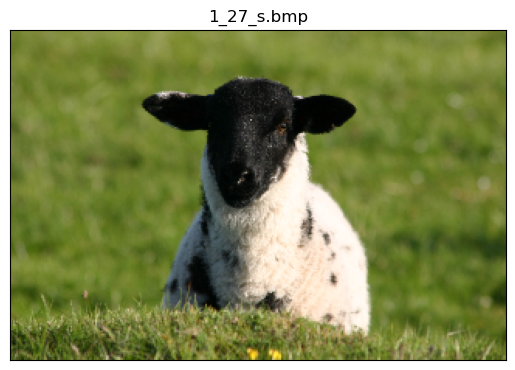

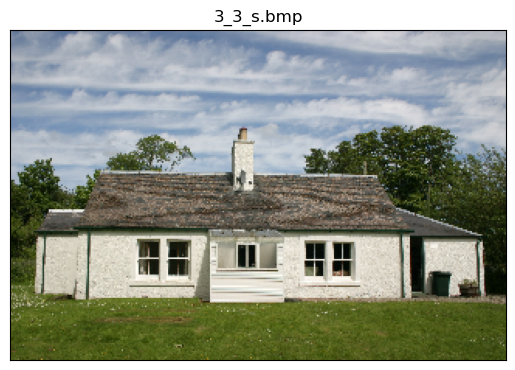

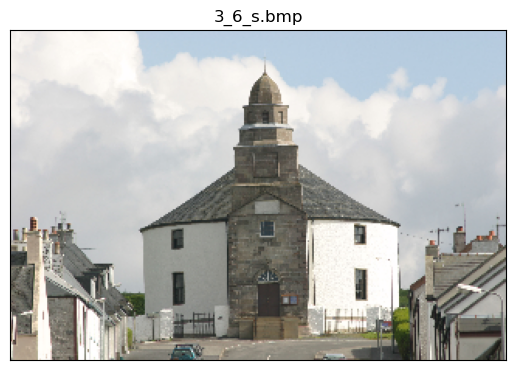

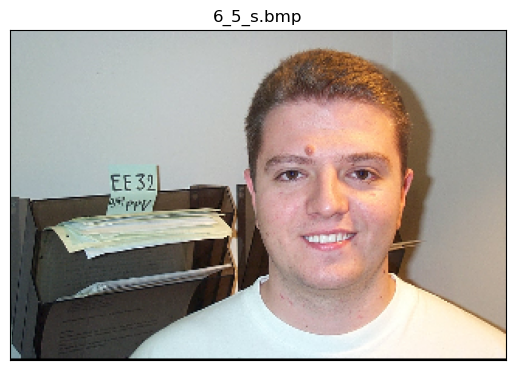

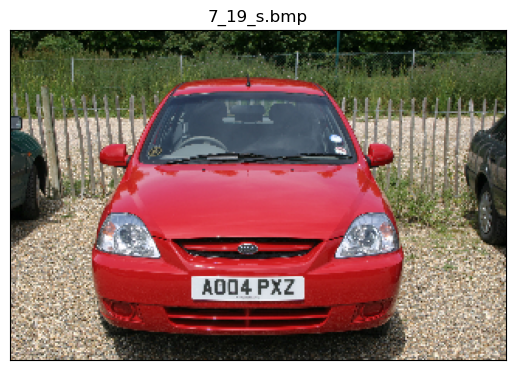

In [4]:
for i in im_list:
    plot_image(cv2.imread(i),i.split("/")[-1])

### Question 1: Perform k-means on image pixels `(r, g, b, x, y)`. (40 points)

The k-means clustering algorithm is an unsupervised algorithm which, for some items and for some specified number of clusters represented by cluster centers, minimizes the distance between items and their associated cluster centers. It does so by iteratively assigning items to a cluster and recomputing the cluster center based on the assigned items.

Complete the pixel clustering function. It should take input an image (shape = `(n, m, 3)`) and number of clusters. Each pixel should be represented by a vector with 3 values: `(r, g, b, x, y)`.

Then, let our provided code plot the pixelwise and superpixel plots for the cow image (`1_22_s.bmp`), using your `cluster_pixels` implementation with the provided values for the number of clusters: `5, 10, 25, 50, 150`.




/home/ani/.local/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/tmp/ipykernel_18593/4190627205.py:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('hsv',n+1)
/home/ani/.local/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/tmp/ipykernel_18593/4190627205.py:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get

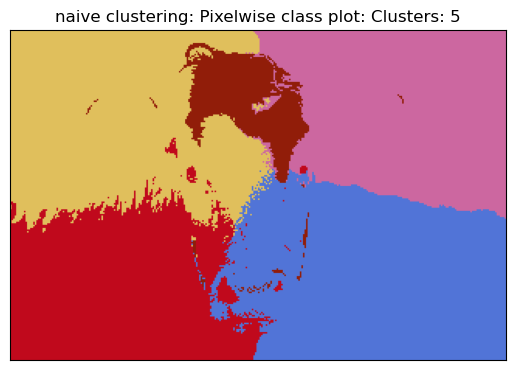

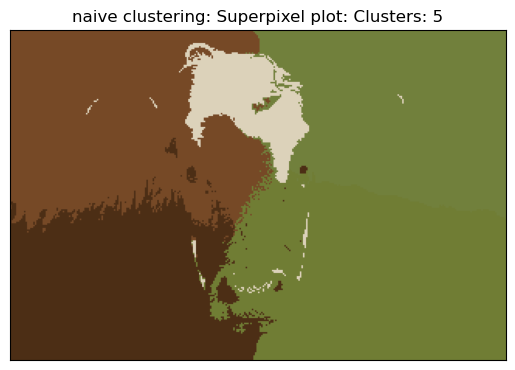

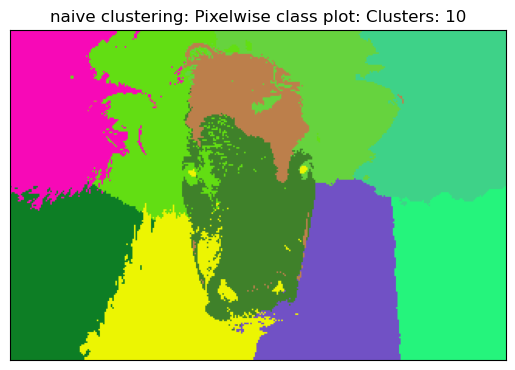

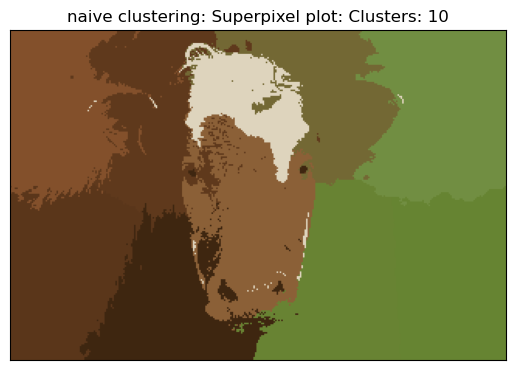

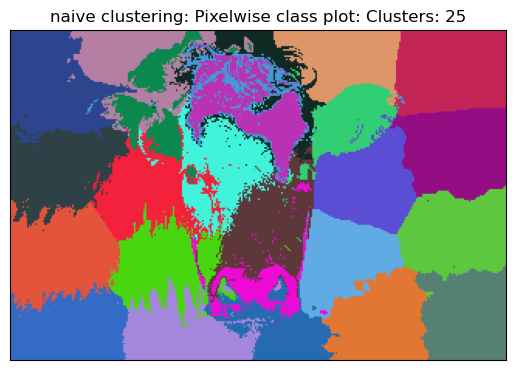

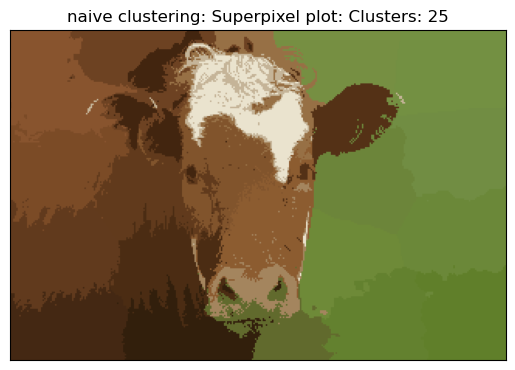

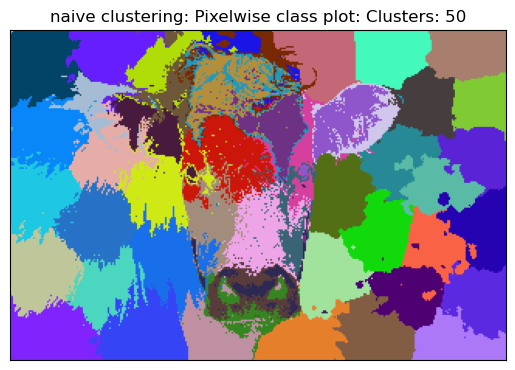

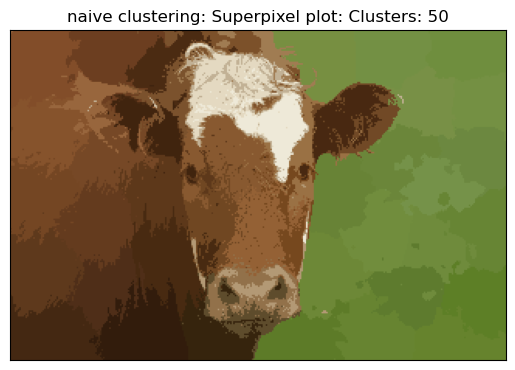

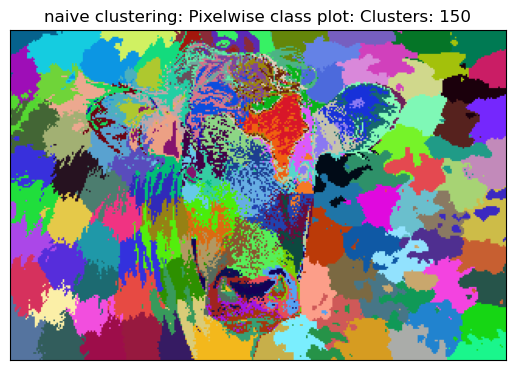

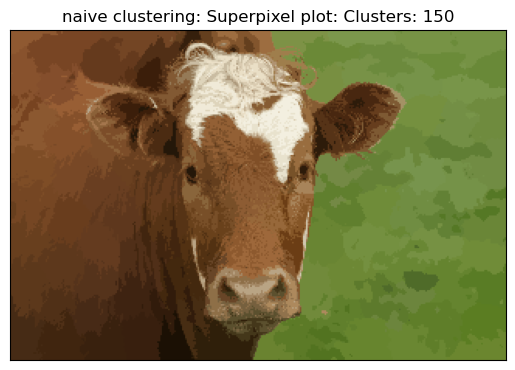

In [29]:
from sklearn.cluster import KMeans
import numpy as  np
import itertools

def cluster_rgbxy(im,k):
    """
    Given image im and asked for k clusters, return nXm size 2D array
    segmap[0,0] is the class of pixel im[0,0,:]
    """
    # assert 1==2," NOT IMPLEMENTED"
    #segmap is nXm. Each value in the 2D array is the cluster assigned to that pixel
    # store rgb values

    ####### BRUTE FORCE #######
    # features = []
    # for i in range(0, im.shape[1]):
    #   for j in range(0, im.shape[0]):
    #     arr = []
    #     arr.append(im[j, i, 0])
    #     arr.append(im[j, i, 1])
    #     arr.append(im[j, i, 2])
    #     arr.append(i)
    #     arr.append(j)
    #     features.append(arr)
    ############################

    ####### NUMPY IMPLEMENTATION ######
    r = np.ravel(im[:, :, 0])[:, np.newaxis]
    g = np.ravel(im[:, :, 1])[:, np.newaxis]
    b = np.ravel(im[:, :, 2])[:, np.newaxis]
    idx_cols = np.arange(0, im.shape[1])
    idx_rows = np.arange(0, im.shape[0])
    idx_mesh = np.array(list(itertools.product(idx_rows, idx_cols, repeat=True)))
    # features = np.concatenate((r, g, b, idx_mesh), axis=1)
    features = np.concatenate((r, g, b, idx_mesh), axis=1)
    ###################################
    kmeans = KMeans(n_clusters=k).fit(features)
    clusters = kmeans.labels_
    segmap = np.zeros((im.shape[0], im.shape[1]))

    # the values are stored as (r, g, b, y, x) => must change to x, y although it doesn't matter
    for i in range(0, len(features)):
      segmap[features[i][3], features[i][4]] = clusters[i]
    return segmap

im = cv2.imread(im_list[0])
for k in [5, 10, 25, 50, 150]:
    clusters = cluster_rgbxy(im,k)
    _ = rgb_segment(clusters,n = k, title =  "naive clustering: Pixelwise class plot: Clusters: " + str(k),legend = False)
    superpixel_plot(im,clusters,title =  "naive clustering: Superpixel plot: Clusters: "+ str(k))

Pick your favorite superpixel **k** value and plot results for all 6 images in `im_list`.

/home/ani/.local/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/tmp/ipykernel_18593/4190627205.py:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('hsv',n+1)
/home/ani/.local/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/tmp/ipykernel_18593/4190627205.py:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get

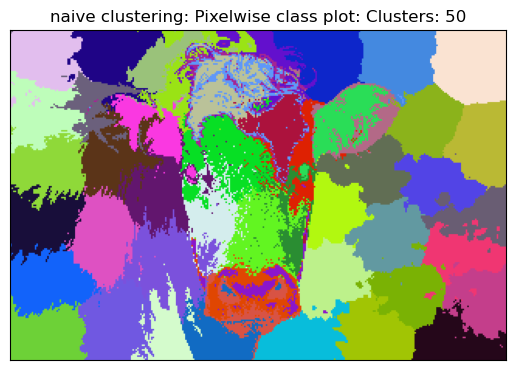

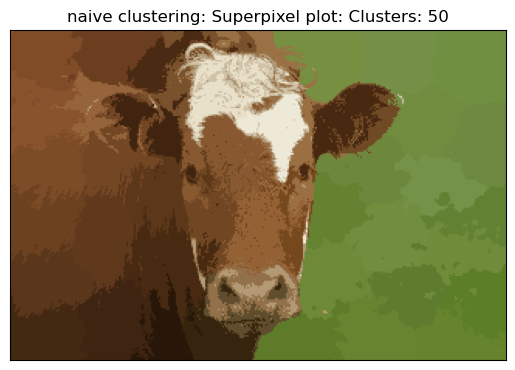

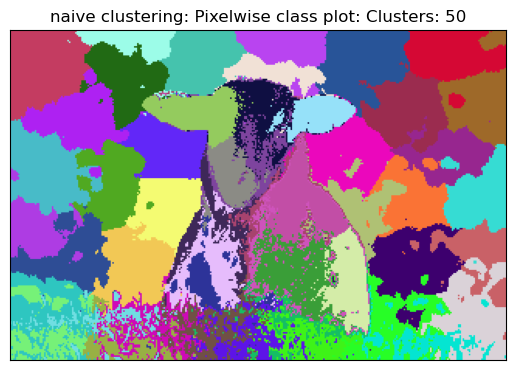

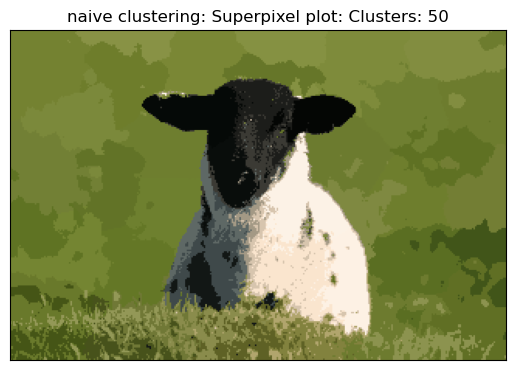

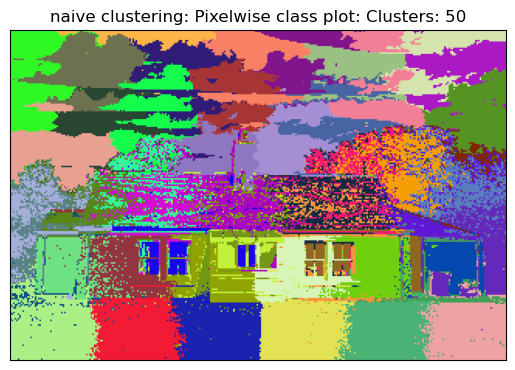

...

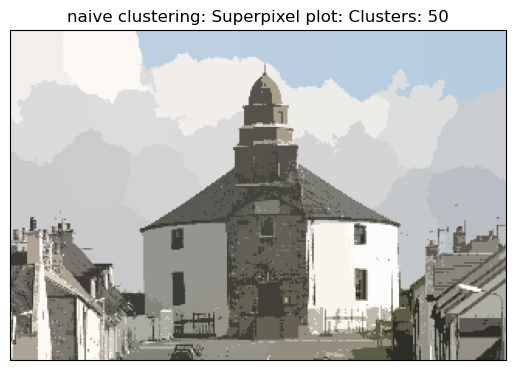

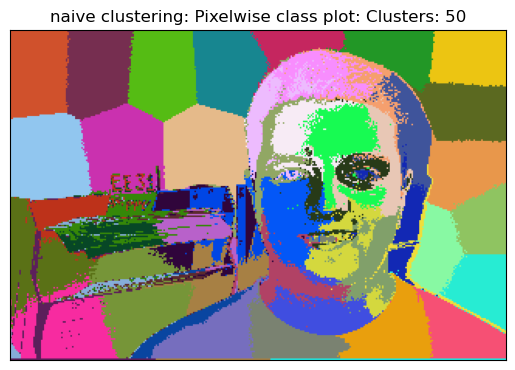

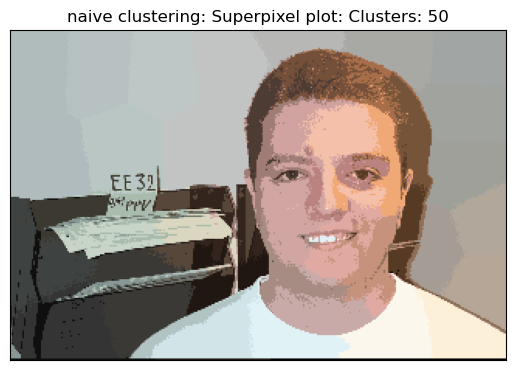

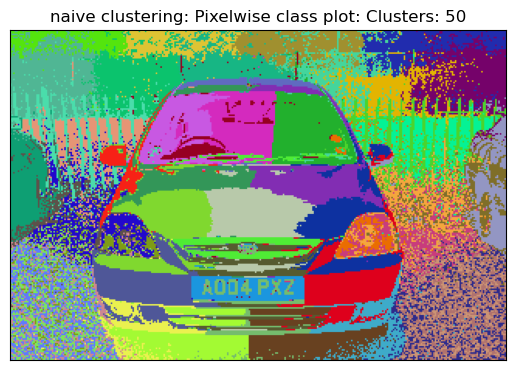

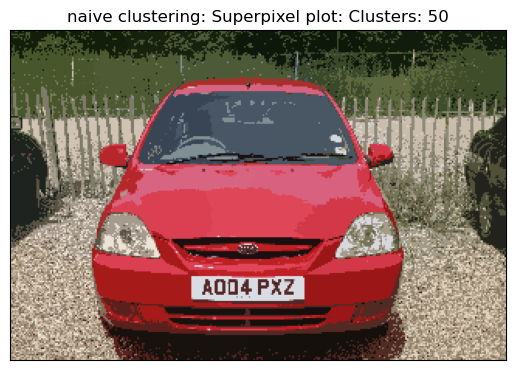

In [30]:
# TODO: plot for 6 images with chosen k value
# lets do for 50 clusters
k = 50
for im_ in im_list:
    im = cv2.imread(im_)
    clusters = cluster_rgbxy(im,k)
    _ = rgb_segment(clusters,n = k, title =  "naive clustering: Pixelwise class plot: Clusters: " + str(k),legend = False)
    superpixel_plot(im,clusters,title =  "naive clustering: Superpixel plot: Clusters: "+ str(k))

### Question 2: Replicate SLIC and Show Results for 6 Images (50 points)

It doesn't look like we have a very favourable outcome with superpixels being implemented with simple clustering. Can we do better? Have a look at the SLIC paper [here](https://www.iro.umontreal.ca/~mignotte/IFT6150/Articles/SLIC_Superpixels.pdf). Incorporate S and m and redefine your distance metric as per the paper.

**Finding an existing implementation of SLIC and using it for your assigment would be considered cheating.**

In [35]:
from matplotlib.colors import CenteredNorm
import math
import itertools
############Algorithm############
#Compute grid steps: S - done
#you can explore different values of m
#initialize cluster centers [l,a,b,x,y] using - done
#Perturb for minimum G - done
#while not converged
##for every pixel:
####  compare distance D_s with each cluster center within 2S X 2S.
####  Assign to nearest cluster
##calculate new cluster center

# Brute Force Method
def find_cluster_centers(S, img_width, img_height):
  centers = []
  # start with height = S/2, width = S/2 for first cluster center
  height = S//2
  width = S//2
  while height < img_height:
    while width < img_width:
      centers.append([height, width])
      width = width + S
    # reinitialize width
    width = S//2
    # increment height to the next row of grid
    height = height + S
  return centers

# Numpy Implementation
def find_cluster_centers(S,k, img_width, img_height):
    c_x = np.arange(S//2, img_width, S)
    c_y = np.arange(S//2, img_height, S)
    centers = np.array(list(itertools.product(c_y, c_x, repeat=True)), dtype=np.int16)[0:k,:]
    return centers

def find_pixel_level_gradient(x, y, img):
  grad = np.linalg.norm(img[y, x+1, :] - img[y, x-1, :], ord=None) \
         + np.linalg.norm(img[y+1, x, :] - img[y-1, x, :], ord=None)
  return grad

# 8-neighborhood of a pixel
def find_neighbors(center, n):
  n_x = np.arange(center[1] - (n-1)/2, center[1] + (n-1)/2 + 1, 1)
  n_y = np.arange(center[0]-(n-1)/2, center[0] + (n-1)/2 + 1, 1)
  neighbors = np.array(list(itertools.product(n_y, n_x)))
  return neighbors

# shift cluster_center to minimum gradient in a nxn neighborhood
def perturb_cluster_centers(centers, n, img):
  perturbed_centers = []
  for center in centers:
    grad_min = np.inf
    min_loc = []
    neighbors = find_neighbors(center, n)
    for neighbor in neighbors:
      grad = find_pixel_level_gradient(int(neighbor[1]), int(neighbor[0]), img)
      grad_min = np.minimum(grad, grad_min)
      min_loc = neighbor
    perturbed_centers.append(min_loc)
  return np.array(perturbed_centers, dtype=np.int16)

# compute distance
def compute_distance(center, x_i, y_i, img, S, m):
  l_k = img[center[0], center[1], 0].astype("float32")
  a_k = img[center[0], center[1], 1].astype("float32")
  b_k = img[center[0], center[1], 2].astype("float32")
  l_i = img[y_i, x_i, 0].astype("float32")
  a_i = img[y_i, x_i, 1].astype("float32")
  b_i = img[y_i, x_i, 2].astype("float32")
  d_lab =  math.sqrt((l_k - l_i)**2 + (a_k - a_i)**2 +  (b_k - b_i)**2)
  d_xy = math.sqrt((center[1] - x_i)**2 + (center[0] - y_i)**2)
  D_s = d_lab + (m/S)*d_xy
  return D_s

# def update_maps(centers, img, S, m, segmap, distmap):
#   for idx, center in enumerate(centers):
#     neighbors_2s = find_neighbors(center, 2*S)
#     for neighbor in neighbors_2s:
#       y_n = int(neighbor[0])
#       x_n = int(neighbor[1])
#       # edge cases
#       if y_n < 0 or y_n >= img.shape[0]:
#         continue
#       else:
#         if(x_n < 0 or x_n >= img.shape[1]):
#           continue
#         else:
#           D_s = compute_distance(center, x_n, y_n, img, S, m)
#           if(D_s < distmap[y_n, x_n]):
#             distmap[y_n, x_n] = D_s
#             segmap[y_n, x_n] = idx + 1


def update_maps(centers, img, S, m, segmap, distmap):
  for i in range(0, img.shape[0]):
    for j in range(0, img.shape[1]):
      p = np.array([i, j], dtype=np.int16)
      # neighbors_2s = find_neighbors(p, 2*S)
      min_x = j - (2*S - 1)//2
      max_x = j + (2*S - 1)//2
      min_y = i - (2*S - 1)//2
      max_y = i + (2*S - 1)//2
      for idx, center in enumerate(centers):
        if (center[0] >= min_y and center[0] < max_y and center[1] < max_x  and center[1] >= min_x):
          D_s = compute_distance(center, j, i, img, S, m)
          if(D_s < distmap[i, j]):
            distmap[i, j] = D_s
            segmap[i, j] = idx
        else: continue

def update_cluster_centers(centers, segmap):
  for idx, center in enumerate(centers):
    cluster_indices = np.argwhere(segmap==idx)
    new_center = np.average(cluster_indices, axis=0).astype("int16")
    centers[idx] = new_center

# compute slic
def SLIC(im, k):
    """
    Input arguments:
    im: image input
    k: number of cluster segments


    Compute
    S: As described in the paper
    m: As described in the paper (use the same value as in the paper)
    follow the algorithm..

    returns:
    segmap: 2D matrix where each value corresponds to the image pixel's cluster number
    """
    # initialize a distance map
    img = cv2.cvtColor(im, cv2.COLOR_BGR2LAB)
    distmap = np.full((img.shape[0], img.shape[1]),np.inf)
    segmap = np.zeros((img.shape[0], img.shape[1]), dtype=np.int16)

    N = img.shape[0] * img.shape[1] # Total Number of Pixels
    S = np.floor(np.sqrt(float(N)/float(k))) # Grid Step Size
    # Sample cluster centers
    centers = find_cluster_centers(S, k, img.shape[1], img.shape[0])
    perturbed_centers =  perturb_cluster_centers(centers,5, img)

    # iterate till convergence (L1 distance between previous and current centers < E)
    # Let E = 0.001
    for i in range(0, 15):
      update_maps(perturbed_centers, img, S, 50, segmap, distmap)
      update_cluster_centers(perturbed_centers, segmap)
    return segmap


With SLIC implemented, plot results for all 6 images.

Using m = 50 and perturbing centers within a size of 5x5

/tmp/ipykernel_18593/4190627205.py:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('hsv',n+1)


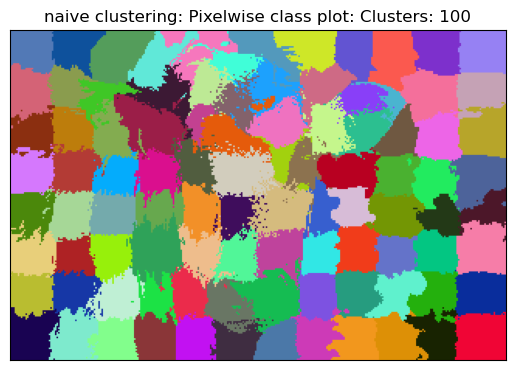

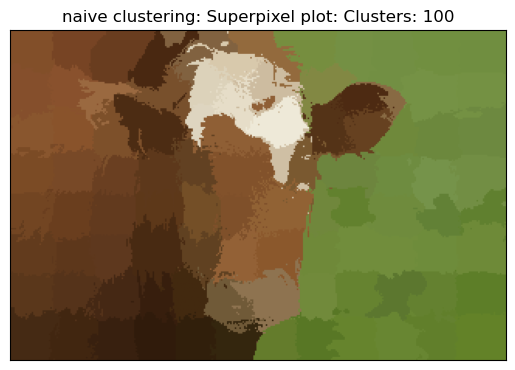

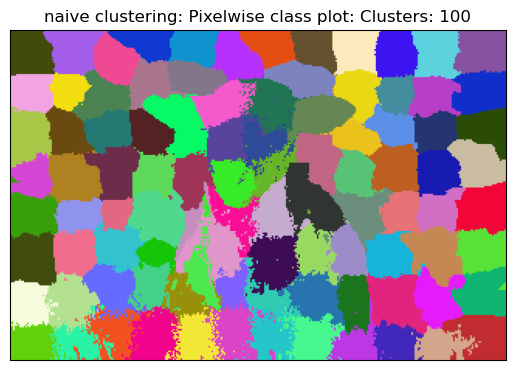

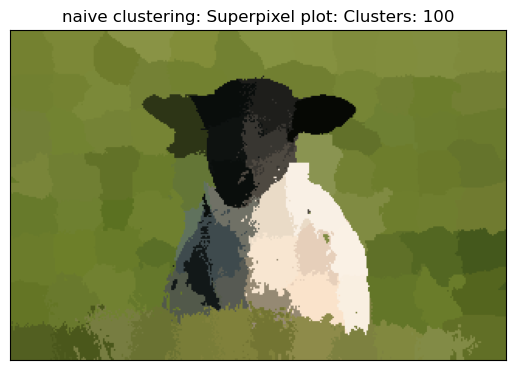

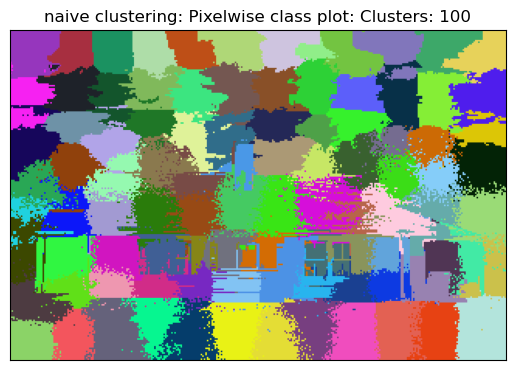

...

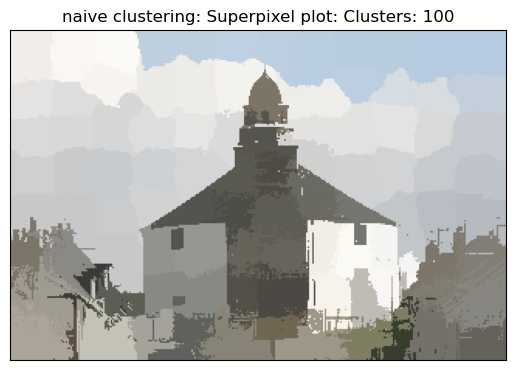

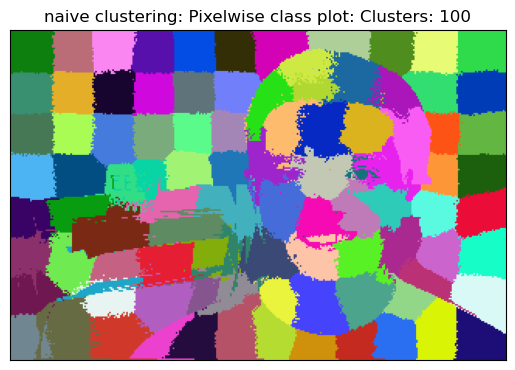

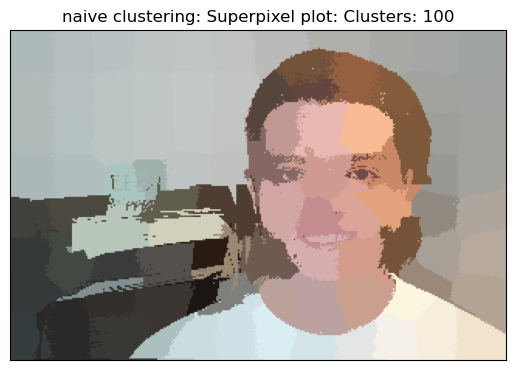

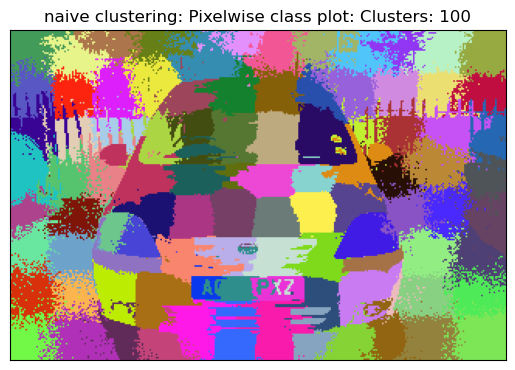

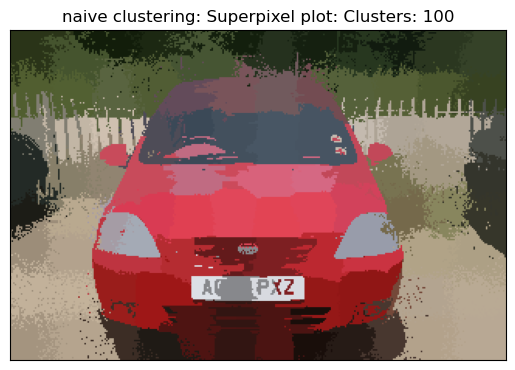

In [36]:
k = 100

for im_ in im_list:
    im = cv2.imread(im_)
    clusters = SLIC(im, k)
    _ = rgb_segment(clusters,n = k, title =  "naive clustering: Pixelwise class plot: Clusters: " + str(k),legend = False)
    im = cv2.imread(im_)
    superpixel_plot(im,clusters,title =  "naive clustering: Superpixel plot: Clusters: "+ str(k))

### Question 3: What advantage did the SLIC give compared to `(r, g, b, x, y)`? Please answer in 3 sentences or fewer. (10 points)

Your Answer:
Superpixels obtained by SLIC are have a more uniform size unlike Kmeans(r,g,b,x,y) which produces superpixels of arbitrary sizes.Because of this, KMeans(r,g,b,x,y) generates more segments than necessary making the segmentation more complex (Over segmentation). Aside from that SLIC offers computational efficiency as the search space is reduced to 2S*2S

### Bonus Question 4: Enforce connectivity (20 points, OPTIONAL)
There are many superpixels which are very small and disconnected from each other. Merge them with larger superpixels

O(N) algorithm:
1. Set minimum size of superpixel
2. If region smaller than threshold, assign to nearest cluster

Plot results for the 6 images.


In [121]:
def enforce_connectivity(segmap, minimum_area=None):
    clusters = np.unique(segmap)
    area_map = {}
    index_map = {}
    centroid = []
    area_list = []
    new_label_map = {}

    for clust in clusters:
        ind = np.argwhere(segmap==clust)
        area_map[clust] = ind.shape[0]
        area_list.append(len(ind))
        centroid.append(np.average(ind, axis=0).astype('int16'))
        
    # Assume minimum area to be mean - std_dev
    if(minimum_area is None):
        area_list = np.array(area_list)
        min_area = area_list.mean() - area_list.std()
    else: 
        min_area = minimum_area
    
    for clust in clusters:
        area_clust = np.argwhere(segmap==clust).shape[0]
        if area_clust < min_area:
            indices = np.argwhere(segmap==clust)
            min_dist, new_cluster = find_closest_cluster(centroid[clust], centroid)
            new_label_map[clust] = new_cluster
        
    new_segmap = segmap
    for key in new_label_map:
        new_segmap[new_segmap==key] = new_label_map[key]
        
    return new_segmap

def find_closest_cluster(curr_centroid, centroid_list):
    # just take L1 distance:
    min_dist = np.inf
    min_cluster = None
    for idx, centroid in enumerate(centroid_list):
        diff_x = centroid[1] - curr_centroid[1]
        diff_y = centroid[0] - curr_centroid[0]
        l1_dist = diff_x*2 + diff_y**2
        if l1_dist < min_dist:
            min_dist = l1_dist
            min_cluster = idx
    return min_dist, min_cluster
        

/tmp/ipykernel_18593/4190627205.py:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('hsv',n+1)


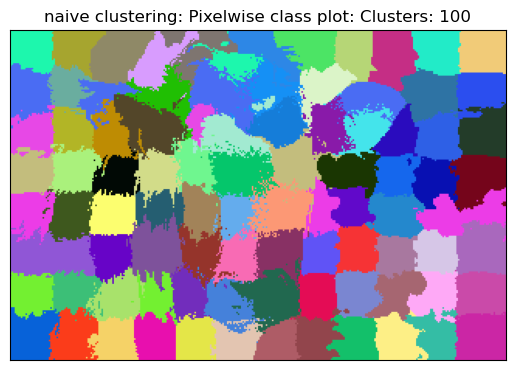

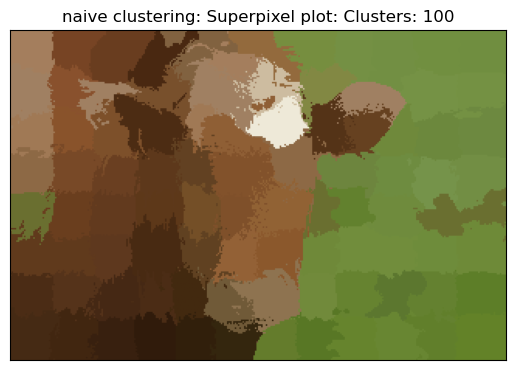

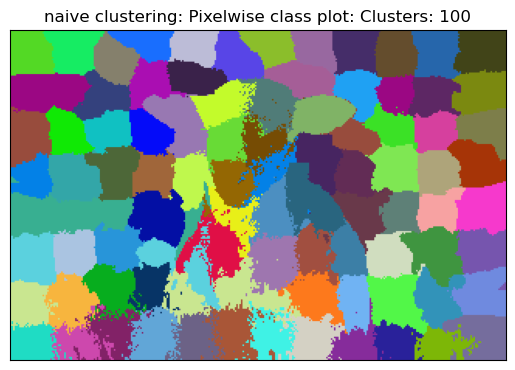

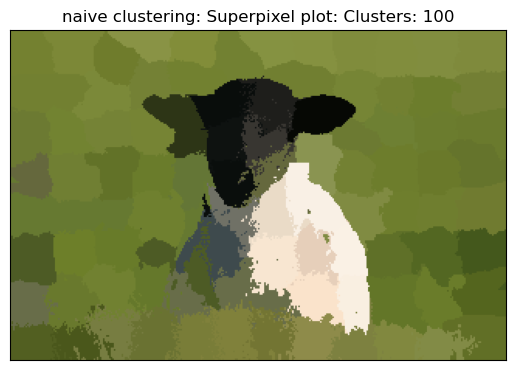

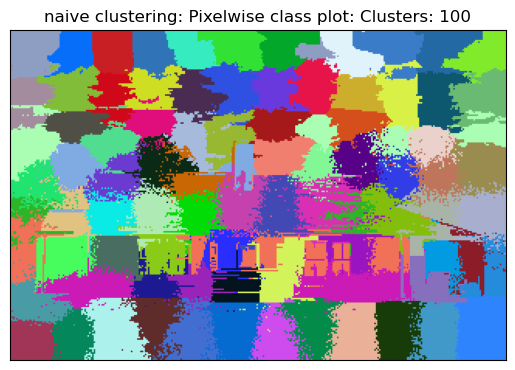

...

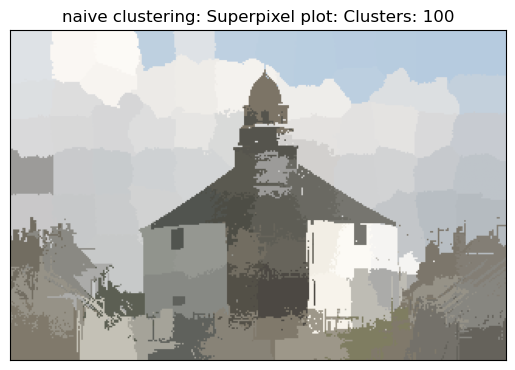

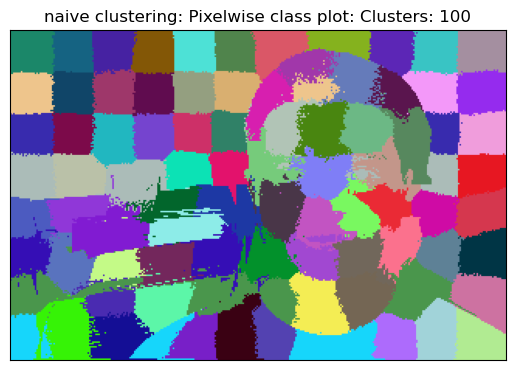

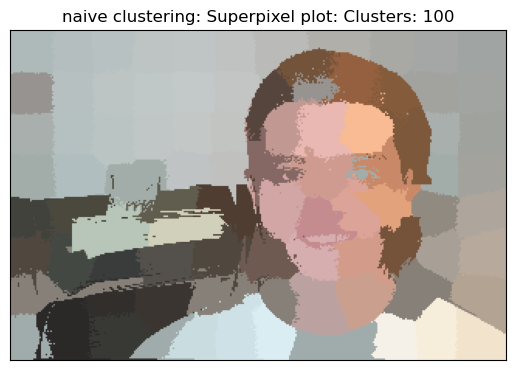

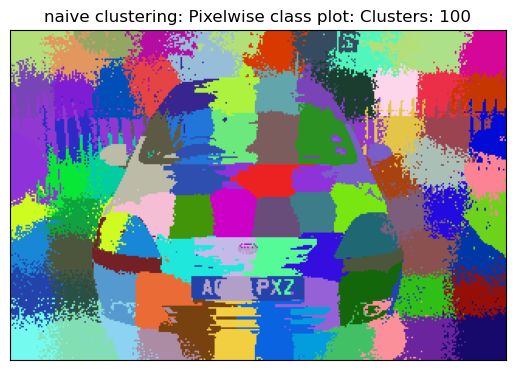

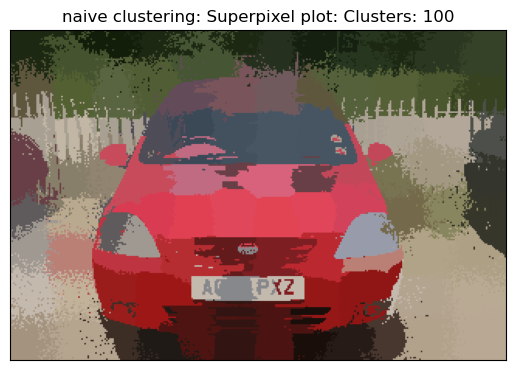

In [122]:
# Plotting for all images
k = 100
for im_ in im_list:
    im = cv2.imread(im_)
    segmap = SLIC(im, k)
    new_segmap = enforce_connectivity(segmap=segmap)
    _ = rgb_segment(new_segmap,n = k, title =  "naive clustering: Pixelwise class plot: Clusters: " + str(k),legend = False)
    im = cv2.imread(im_)
    superpixel_plot(im,new_segmap,title =  "naive clustering: Superpixel plot: Clusters: "+ str(k))

It can be noticed that the smaller superpixels have merged with closer superpixels. 
Algorithm used:

    - Find centroids of all super pixels
    - For each centroid:
        - check if size is greater than minimum size.(size is defined by count of pixels in that superpixel)
        - if size < size_minimum then find closest superpixel (L2 distance works better) 
          and assign the cluster of closest superpixel
    - Replace the older clusters with newly assigned clusters in the segmentation map


## Part 2: Segmentation

For this part, you will use your best superpixels to build an image segmentation system. Alternatively, you can use SLIC from some library, as we demonstrate in the Data section that follows.

### Data

This is mostly the same as the last part, except now we also need to consider the annotated ground truth segmentation maps.

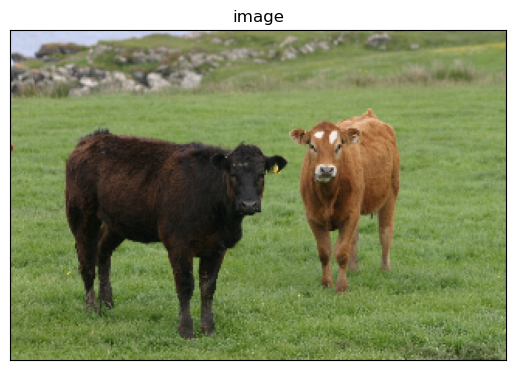

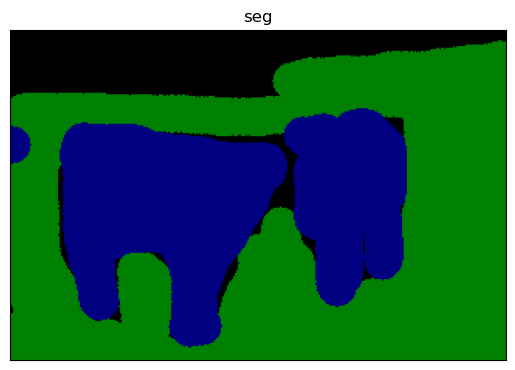

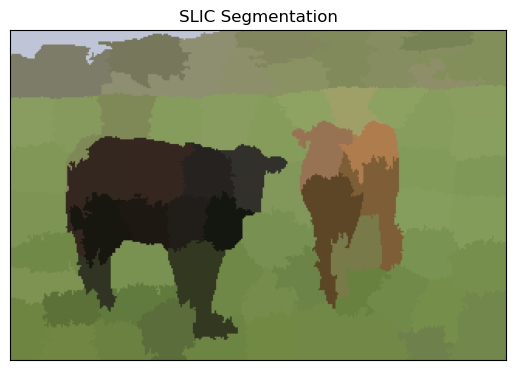

In [123]:
#  plot a sample image and its ground truth segments
image_sample = cv2.imread('MSRC_ObjCategImageDatabase_v1/1_19_s.bmp')
seg_sample = cv2.imread('MSRC_ObjCategImageDatabase_v1/1_19_s_GT.bmp')
plot_image(image_sample, 'image')
plot_image(seg_sample, 'seg')

#  run SLIC on the sample image and plot the corresponding SLIC segments
from skimage.segmentation import slic

segments_sample = slic(image_sample, n_segments=100, compactness=10)
superpixel_plot(image_sample, segments_sample, title = "SLIC Segmentation")

In [124]:
from IPython import embed
import os
current_directory = os.getcwd()
msrc_directory = current_directory + '/MSRC_ObjCategImageDatabase_v1'

#Superpixel dataset preparation

# from Dataset_v1
SEG_LABELS_LIST_v1 = [
    {"id": 9, "name": "void",       "rgb_values": [0,   0,    0]},
    {"id": 0,  "name": "building",   "rgb_values": [128, 0,    0]},
    {"id": 1,  "name": "grass",      "rgb_values": [0,   128,  0]},
    {"id": 2,  "name": "tree",       "rgb_values": [128, 128,  0]},
    {"id": 3,  "name": "cow",        "rgb_values": [0,   0,    128]},
    {"id": 4,  "name": "sky",        "rgb_values": [128, 128,  128]},
    {"id": 5,  "name": "airplane",   "rgb_values": [192, 0,    0]},
    {"id": 6, "name": "face",       "rgb_values": [192, 128,  0]},
    {"id": 7, "name": "car",        "rgb_values": [64,  0,    128]},
    {"id": 8, "name": "bicycle",    "rgb_values": [192, 0,    128]},
    {"id": 9, "name": "horse",       "rgb_values": [128,   0,    128]},
    {"id": 9, "name": "water",       "rgb_values": [64,   128,    0]},
    {"id": 9, "name": "mountain",       "rgb_values": [64,   0,    0]},
    {"id": 9, "name": "sheep",       "rgb_values": [0,   128,    128]}]

# from Dataset_v2
SEG_LABELS_LIST_v2 = [
    {"id": -1, "name": "void",       "rgb_values": [0,   0,    0]},
    {"id": 0,  "name": "building",   "rgb_values": [128, 0,    0]},
    {"id": 1,  "name": "grass",      "rgb_values": [0,   128,  0]},
    {"id": 2,  "name": "tree",       "rgb_values": [128, 128,  0]},
    {"id": 3,  "name": "cow",        "rgb_values": [0,   0,    128]},
    {"id": 4,  "name": "horse",      "rgb_values": [128, 0,    128]},
    {"id": 5,  "name": "sheep",      "rgb_values": [0,   128,  128]},
    {"id": 6,  "name": "sky",        "rgb_values": [128, 128,  128]},
    {"id": 7,  "name": "mountain",   "rgb_values": [64,  0,    0]},
    {"id": 8,  "name": "airplane",   "rgb_values": [192, 0,    0]},
    {"id": 9,  "name": "water",      "rgb_values": [64,  128,  0]},
    {"id": 10, "name": "face",       "rgb_values": [192, 128,  0]},
    {"id": 11, "name": "car",        "rgb_values": [64,  0,    128]},
    {"id": 12, "name": "bicycle",    "rgb_values": [192, 0,    128]},
    {"id": 13, "name": "flower",     "rgb_values": [64,  128,  128]},
    {"id": 14, "name": "sign",       "rgb_values": [192, 128,  128]},
    {"id": 15, "name": "bird",       "rgb_values": [0,   64,   0]},
    {"id": 16, "name": "book",       "rgb_values": [128, 64,   0]},
    {"id": 17, "name": "chair",      "rgb_values": [0,   192,  0]},
    {"id": 18, "name": "road",       "rgb_values": [128, 64,   128]},
    {"id": 19, "name": "cat",        "rgb_values": [0,   192,  128]},
    {"id": 20, "name": "dog",        "rgb_values": [128, 192,  128]},
    {"id": 21, "name": "body",       "rgb_values": [64,  64,   0]},
    {"id": 22, "name": "boat",       "rgb_values": [192, 64,   0]}]

# create a map rgb_2_label, where mapping the ground truth 3-d array segmentation into a single ID label.
rgb_2_label = {}
label_2_rgb = {} # also need a reverse map, between id and rgb values to segment an image
for i in SEG_LABELS_LIST_v1:
    rgb_2_label[tuple(i['rgb_values'])] = i['id']
    label_2_rgb[i["id"]] = tuple(i['rgb_values'])

### Question 5: Superpixel Dataset (30 points)

First, we dilate each superpixel and save the output superpixel patch from SLIC into 224X224 size image (after rescaling), alongwith the ground truth segments label.

For the purpose of consistency, we adopt the existing SLIC implementation from the scikit-learn machine learning package.

Suggested algorithm: Save the superpixels along with their segmentation class. You could implement this as follows:

For each image
1. Get superpixels sp_i for image x. We adopt 100 segments in this assignment, 'segments = slic(image, n_segments=100, compactness=10)'.
2. For every superpixel sp_i in the image, \\
    2.1. find the smallest rectangle which can enclose sp_i <br>
    2.2. Dilate the rectangle by 3 pixels.<br>
    2.3. Get the same region from the segmentation image (from the file with similar name with *_GT). The class for this sp_i is mode of segmentation classes in that same region. Save the dilated region as npy (jpg is lossy for such small patches).<br>


Alternatively, you could create a single csv with columns segment patch location, class label for each sp_i of each image.<br>italicized text

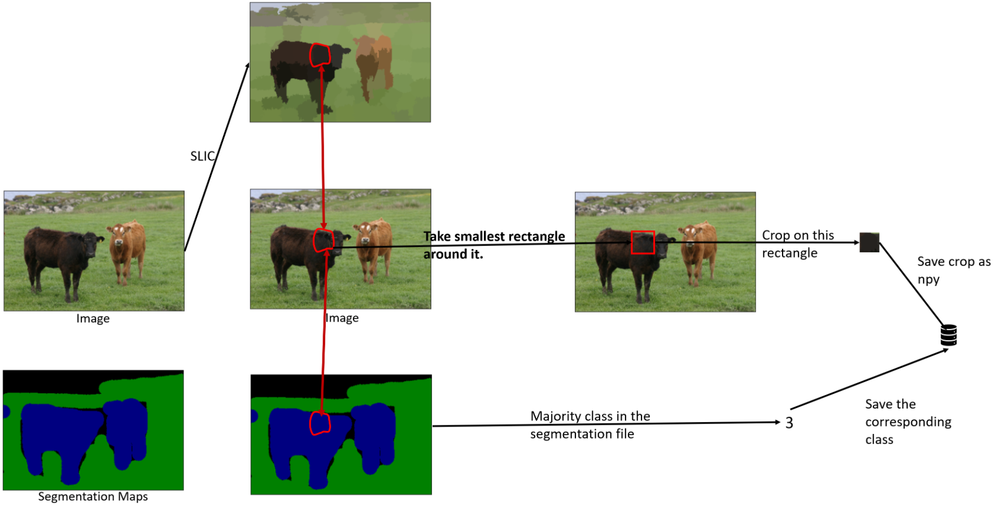


In addition to your code, **the primary graded deliverables** for this question are the 12 demo images we request after you have written code for the dataset.

In [125]:
image_sample = cv2.imread('MSRC_ObjCategImageDatabase_v1/1_19_s.bmp')
seg_sample = cv2.imread('MSRC_ObjCategImageDatabase_v1/1_19_s_GT.bmp')
# plot_image(image_sample, 'image')
# plot_image(seg_sample, 'seg')

#  run SLIC on the sample image and plot the corresponding SLIC segments
from skimage.segmentation import slic

segments_sample = slic(image_sample, n_segments=100, compactness=10)
clusts = np.unique(segments_sample)

In [152]:
# Creation of dataset folder
import os
import shutil
if os.path.exists('./datasets/train/train.txt'):
    os.remove('./datasets/train/train.txt')

if not os.path.exists('./datasets'):
  os.mkdir('./datasets')
else:
  shutil.rmtree('./datasets', ignore_errors=True)

if not os.path.exists('./datasets/train'):
  os.mkdir('./datasets/train')
else:
  shutil.rmtree('./datasets/train', ignore_errors=True)

if not os.path.exists('./datasets/test'):
  os.mkdir('./datasets/test')
else:
  shutil.rmtree('./datasets/test', ignore_errors=True)

if not os.path.exists('./datasets/train/images'):
  os.mkdir('./datasets/train/images')
else:
  shutil.rmtree('./datasets/train/images', ignore_errors=True)

if not os.path.exists('./datasets/test/images'): 
  os.mkdir('./datasets/test/images')
else:
  shutil.rmtree('./datasets/test/images', ignore_errors=True)

In [153]:
import random
from sklearn.model_selection import train_test_split
# List of all the files in the directory
files = os.listdir(msrc_directory)
# Sorting the file list
files.sort()
img_files = []
gt_files = []
for file in files:
  if file.find('GT') == -1:
    img_files.append(file)
  else:
    gt_files.append(file)
img_files = np.array(img_files[0:len(img_files) - 2]) # remove the meta data files
gt_files = np.array(gt_files[0:len(gt_files)])

# create a randomly shuffled train and test split
img_train, img_test, gt_train, gt_test = train_test_split(img_files, gt_files, test_size=0.2)
print("Train Size: ",img_train.shape[0], gt_train.shape[0])
print("Test Size: ",img_test.shape[0], gt_test.shape[0])

Train Size:  192 192
Test Size:  48 48


In [155]:
from scipy import stats
from skimage.segmentation import slic
import shutil
from datetime import datetime
import pandas as pd
import itertools
import math

# run SLIC on each original images and save the (segment patch, ID label) pair
# segments = slic(image, n_segments=100, compactness=10)
# it may take up to half an hour to process, depending on the hardware resources
# save the output file names to train.txt
# Alternatively, you don't save the segment patch and ID label offline, instead,
# you process them on the fly later.

def create_dataset(files, files_gt, file_name):
  print(f'Creating {file_name} Dataset...')
  print("Start time: ", datetime.now().time())
  dataset = []
  for i, file in enumerate(files):
    img_idx = 1
    print("Image File Name: ", file)
    print("GT File Name: ", files_gt[i])
    image_sample = cv2.imread(f'MSRC_ObjCategImageDatabase_v1/{file}')
    image_sample = cv2.cvtColor(image_sample, cv2.COLOR_BGR2RGB)
    seg_sample = cv2.imread(f'MSRC_ObjCategImageDatabase_v1/{files_gt[i]}')
    seg_sample = cv2.cvtColor(seg_sample, cv2.COLOR_BGR2RGB)
    segments_sample = slic(image_sample, n_segments=100, compactness=10)
    clusts = np.unique(segments_sample)
    rectangles= []
    for clust in clusts:
      area = np.argwhere(segments_sample==clust)
      # dilating pixels by 3
      min_y, max_y = area[:, 0].min() - 3,  area[:, 0].max() + 3
      min_x, max_x = area[:, 1].min() - 3, area[:, 1].max() + 3
      if min_y < 0:
        min_y = 0
      if min_x < 0:
        min_x = 0
      if max_y > image_sample.shape[0]:
        max_y = image_sample.shape[0] - 1
      if max_x > image_sample.shape[1]:
        max_x = image_sample.shape[1]
      rect = [min_x, max_x, min_y, max_y]
    
      # create an array of rectangle extreme coordinates
      rectangles.append(rect)
    for rectangle in rectangles:
      segment_count = {}
      superpixel_dict = {}
      img_crop = image_sample[rectangle[2]: rectangle[3], rectangle[0]:rectangle[1], :]
      for l in range(rectangle[2], rectangle[3]):
        for m in range(rectangle[0], rectangle[1]):
          segment = seg_sample[l, m, :]
          seg_label = 0
          if (tuple(segment) in rgb_2_label):
            seg_label = rgb_2_label[tuple(segment)]
          else:
            # defining non-existing map to void
            seg_label = 9
          if(seg_label in segment_count):
            segment_count[seg_label] += 1
          else:
            segment_count[seg_label] = 1
      # obtaining label with maximum counts in the rectangle
      seg_label = max(segment_count, key= lambda x: segment_count[x])
      superpixel_dict["superpixel_image"] = f'{file}@img_{img_idx}.npy'
      superpixel_dict["superpixel_class"] = seg_label
      dataset.append(superpixel_dict)
      np.save(f'./datasets/{file_name}/images/{file}@img_{img_idx}.npy', img_crop)
      img_idx+=1
  df = pd.DataFrame.from_records(dataset)
  df.to_csv(f'./datasets/{file_name}/{file_name}.csv')
  print("End Time: ", datetime.now().time())

# TRAIN DATASET
create_dataset(img_train, gt_train, 'train')
create_dataset(img_test,gt_test,'test')

Creating train Dataset...
Start time:  19:38:58.296298
Image File Name:  4_27_s.bmp
GT File Name:  4_27_s_GT.bmp
Image File Name:  6_22_s.bmp
GT File Name:  6_22_s_GT.bmp
Image File Name:  6_3_s.bmp
GT File Name:  6_3_s_GT.bmp
Image File Name:  8_8_s.bmp
GT File Name:  8_8_s_GT.bmp
Image File Name:  6_28_s.bmp
GT File Name:  6_28_s_GT.bmp
Image File Name:  3_20_s.bmp
GT File Name:  3_20_s_GT.bmp
Image File Name:  3_19_s.bmp
GT File Name:  3_19_s_GT.bmp
Image File Name:  5_21_s.bmp
GT File Name:  5_21_s_GT.bmp
Image File Name:  1_20_s.bmp
GT File Name:  1_20_s_GT.bmp
Image File Name:  2_8_s.bmp
GT File Name:  2_8_s_GT.bmp
Image File Name:  3_23_s.bmp
GT File Name:  3_23_s_GT.bmp
Image File Name:  7_23_s.bmp
GT File Name:  7_23_s_GT.bmp
Image File Name:  7_1_s.bmp
GT File Name:  7_1_s_GT.bmp
Image File Name:  5_15_s.bmp
GT File Name:  5_15_s_GT.bmp
Image File Name:  7_2_s.bmp
GT File Name:  7_2_s_GT.bmp
Image File Name:  5_14_s.bmp
GT File Name:  5_14_s_GT.bmp
Image File Name:  8_30_s.bm

Image File Name:  7_12_s.bmp
GT File Name:  7_12_s_GT.bmp
Image File Name:  2_11_s.bmp
GT File Name:  2_11_s_GT.bmp
Image File Name:  2_14_s.bmp
GT File Name:  2_14_s_GT.bmp
Image File Name:  7_19_s.bmp
GT File Name:  7_19_s_GT.bmp
Image File Name:  4_26_s.bmp
GT File Name:  4_26_s_GT.bmp
Image File Name:  8_11_s.bmp
GT File Name:  8_11_s_GT.bmp
Image File Name:  2_29_s.bmp
GT File Name:  2_29_s_GT.bmp
Image File Name:  5_17_s.bmp
GT File Name:  5_17_s_GT.bmp
Image File Name:  4_25_s.bmp
GT File Name:  4_25_s_GT.bmp
Image File Name:  3_24_s.bmp
GT File Name:  3_24_s_GT.bmp
Image File Name:  2_25_s.bmp
GT File Name:  2_25_s_GT.bmp
Image File Name:  1_5_s.bmp
GT File Name:  1_5_s_GT.bmp
Image File Name:  8_2_s.bmp
GT File Name:  8_2_s_GT.bmp
Image File Name:  8_18_s.bmp
GT File Name:  8_18_s_GT.bmp
Image File Name:  6_12_s.bmp
GT File Name:  6_12_s_GT.bmp
Image File Name:  1_25_s.bmp
GT File Name:  1_25_s_GT.bmp
Image File Name:  1_28_s.bmp
GT File Name:  1_28_s_GT.bmp
Image File Name:  

In [156]:
import os
import numpy as np
import torch
import torch.utils.data as data
from PIL import Image
from torchvision import transforms
import _pickle as pickle
import torch.nn as nn
import torchvision.models as models
import torch.nn.functional as F

import pandas as pd

# -------------
# Dataset class
# -------------
#
# ``torch.utils.data.Dataset`` is an abstract class representing a
# dataset.
# Your custom dataset should inherit ``Dataset`` and override the following
# methods:
#
# -  ``__len__`` so that ``len(dataset)`` returns the size of the dataset.
# -  ``__getitem__`` to support the indexing such that ``dataset[i]`` can
#    be used to get sp_i sample
#
# Let's create a dataset class for our superpixel dataset. We will
# read the csv in ``__init__`` but leave the reading of images to
# ``__getitem__``. This is memory efficient because all the images are not
# stored in the memory at once but read as required.
#
# Sample of our dataset will be a dict
# ``{'superpixel image': image, 'superpixel class': class}``. Our dataset will take an
# optional argument ``transform`` so that any required processing can be
# applied on the sample. Remember to resize the image using ``transform``.

class SegmentationData(data.Dataset):

    def __init__(self, annotations_file, img_dir, transform=None):
        self.img_labels = pd.read_csv(annotations_file)
        self.img_dir = img_dir
        self.transform = transform


    def __len__(self):
        return len(self.img_labels)

    def __getitem__(self, index):
        img_path = os.path.join(self.img_dir, self.img_labels.iloc[index, 1])
        img = np.load(img_path)
        label = self.img_labels.iloc[index, 2]
        if self.transform:
          img = self.transform(img)
        return (img, label)


In [157]:
# Transforms
tr = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((224,224), interpolation=transforms.InterpolationMode.BILINEAR, max_size=None, antialias='warn'),
    transforms.ToTensor()
])
train_data = SegmentationData('./datasets/train/train.csv', './datasets/train/images', tr)

Show some outputs! Choose 1 image. For that image, plot the image, along with the superpixel map for the image, as you did for Assignment 1. Then, show the first 10 superpixel patches for the image, retrieved from your dataset.

The output for this portion will be 12 images, displayed below your code below.

['4_27_s.bmp@img_1.npy', '4_27_s.bmp@img_2.npy', '4_27_s.bmp@img_3.npy', '4_27_s.bmp@img_4.npy', '4_27_s.bmp@img_5.npy', '4_27_s.bmp@img_6.npy', '4_27_s.bmp@img_7.npy', '4_27_s.bmp@img_8.npy', '4_27_s.bmp@img_9.npy', '4_27_s.bmp@img_10.npy', '4_27_s.bmp@img_11.npy', '4_27_s.bmp@img_12.npy', '4_27_s.bmp@img_13.npy', '4_27_s.bmp@img_14.npy', '4_27_s.bmp@img_15.npy', '4_27_s.bmp@img_16.npy', '4_27_s.bmp@img_17.npy', '4_27_s.bmp@img_18.npy', '4_27_s.bmp@img_19.npy', '4_27_s.bmp@img_20.npy', '4_27_s.bmp@img_21.npy', '4_27_s.bmp@img_22.npy', '4_27_s.bmp@img_23.npy', '4_27_s.bmp@img_24.npy', '4_27_s.bmp@img_25.npy', '4_27_s.bmp@img_26.npy', '4_27_s.bmp@img_27.npy', '4_27_s.bmp@img_28.npy', '4_27_s.bmp@img_29.npy', '4_27_s.bmp@img_30.npy', '4_27_s.bmp@img_31.npy', '4_27_s.bmp@img_32.npy', '4_27_s.bmp@img_33.npy', '4_27_s.bmp@img_34.npy', '4_27_s.bmp@img_35.npy', '4_27_s.bmp@img_36.npy', '4_27_s.bmp@img_37.npy', '4_27_s.bmp@img_38.npy', '4_27_s.bmp@img_39.npy', '4_27_s.bmp@img_40.npy', '4_27_s.

/tmp/ipykernel_18593/4190627205.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


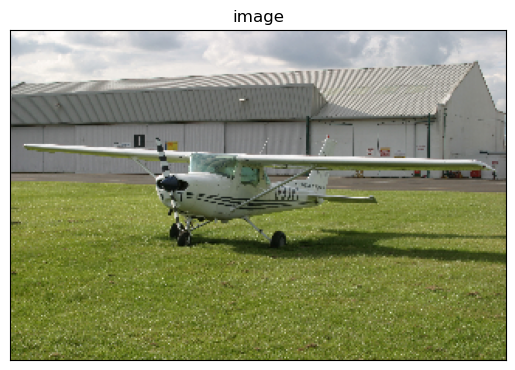

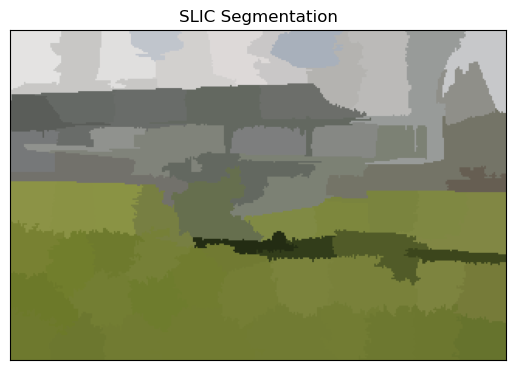

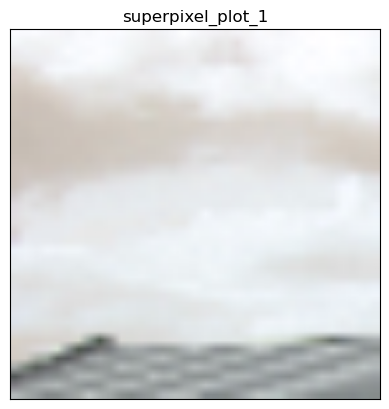

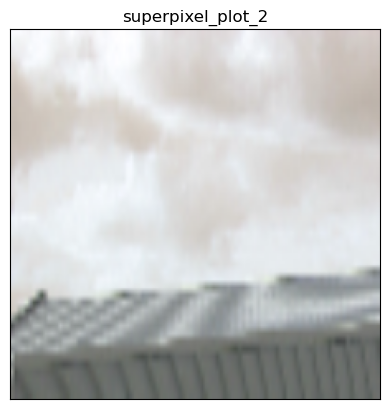

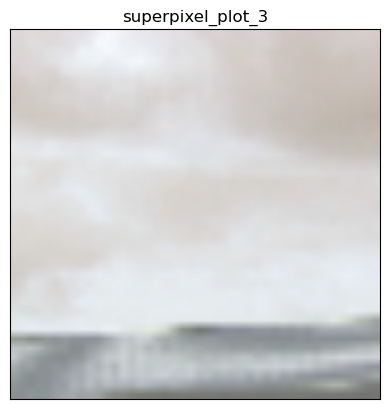

...

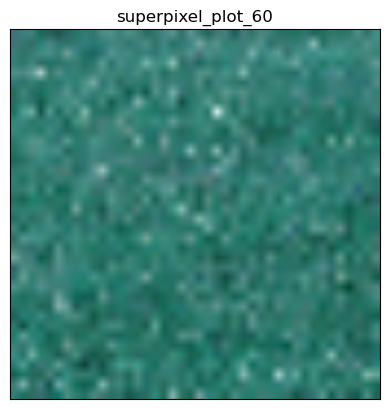

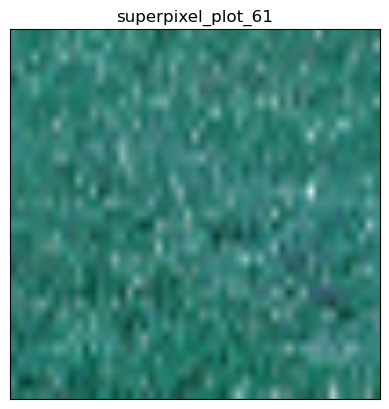

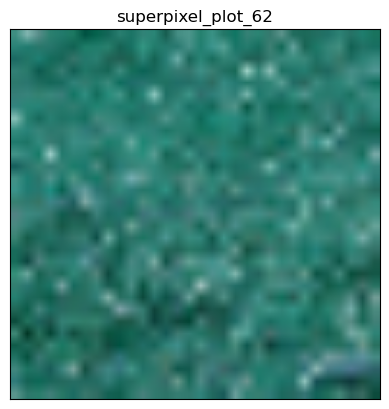

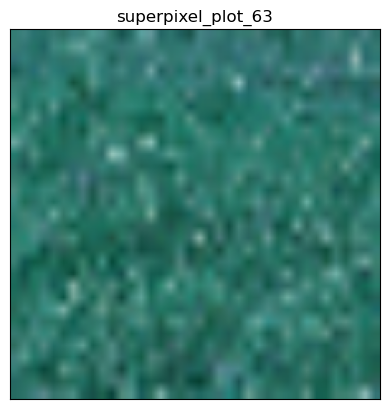

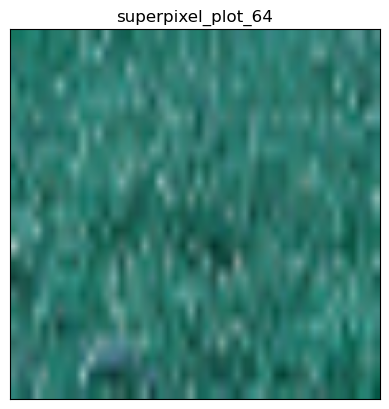

In [158]:
### YOUR CODE TO PLOT 12 images (original RGB + superpixel map + first 10 superpixels) ###

# Fetching the image
img_name = '4_27_s.bmp'
img = cv2.imread(f'MSRC_ObjCategImageDatabase_v1/{img_name}')
df = pd.read_csv('./datasets/train/train.csv')
sp_patches_all = df['superpixel_image'].to_numpy()
sp_patches=[]
for sp_patch in sp_patches_all:
  # if(len(sp_patches) == 10):
  #   break
  if(sp_patch.split("@")[0] == img_name):
    sp_patches.append(sp_patch)
plot_image(img, 'image')

print(sp_patches)
from skimage.segmentation import slic

segs = slic(img, n_segments=100, compactness=10)
superpixel_plot(img, segs, title = "SLIC Segmentation")

# plotting all superpixels
for idx in range(0, len(sp_patches)):
  im, label = train_data.__getitem__(idx)
  plot_image(im.numpy().transpose(1,2,0), f"superpixel_plot_{idx + 1}")

### Question 6: Deep Network (10 points)

You could use a pre-trained network (like VGG) and replace the last few layers with a fully connected layer.

In [159]:
device = None
if (torch.cuda.is_available()):
  device = torch.device("cuda:0")
else:
  device = torch.device('cpu')

print("Using ", device)

def custom_vgg16():
  vgg16 = models.vgg16(pretrained=True)
  for p in vgg16.features.parameters():
    p.requires_grad = False

  inputs = vgg16.classifier[6].in_features
  outputs = 10
  vgg16.classifier[6] = nn.Sequential(
      nn.Linear(inputs, 256),
      nn.Sigmoid(), # using sigmoid, tried with ReLU; sigmoid gave better results
      nn.Dropout(0.5), # using dropout for generalization
      nn.Linear(256, outputs)
  )
  return vgg16

class SegmentationNN(nn.Module):
    def __init__(self):
      super(SegmentationNN, self).__init__()
      self.model = custom_vgg16()
      self.model.to(device)

    def forward(self, X):
        return self.model(X)

Using  cuda:0


### Question 7: Optimizer (10 points)

Finally, we define the classification loss and optimizer such that we can learn a superpixel classifier from the backproporgation algorithm.

In [160]:
# Optimizer
import torch.optim as optim
import torch
import tqdm
import time
class Solver(object):
    def __init__(self, model,epochs = 10, learning_rate=1e-4):
        # Your code
        self.model = model
        self.epochs = epochs
        self.objective = nn.CrossEntropyLoss()
        self.optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-5)
        # define a scheduler which updates the learning rates
        self.scheduler = optim.lr_scheduler.ReduceLROnPlateau(self.optimizer, factor=0.1, patience=5, verbose=True)

    def train(self, data_loader):
      self.model.train()
      start = time.perf_counter()
      for epoch in range(1, self.epochs + 1):
        losses = []
        running_loss = 0
        correct_predictions = 0
        total_samples = 0
        batch = tqdm.tqdm(enumerate(data_loader), total = len(data_loader), leave=True)
        for idx, (img, labels) in batch:
          img = img.to(device=device)
          labels = labels.to(device=device)

          predicted_labels = self.model(img)
          _, preds = torch.max(predicted_labels, 1)

          loss = self.objective(predicted_labels, labels)
          losses.append(loss.item())

          correct_predictions += torch.sum(preds==labels)
          total_samples+=predicted_labels.size(0)

          self.optimizer.zero_grad()
          loss.backward()

          self.optimizer.step()

          batch.set_description(f'Epoch [{epoch}]/{self.epochs}')
          batch.set_postfix(loss=loss.item(), acc=(correct_predictions/total_samples).item())

        avg_loss = sum(losses)/len(losses)
        avg_acc = correct_predictions/total_samples
        self.scheduler.step(avg_loss)

        time_elapsed = time.perf_counter() - start
        print('Epoch: [{}/{}] Time: {}min:{}sec Training Loss: {:.4f} Training Acc: {:.4f}'.format(epoch, self.epochs, time_elapsed//60, time_elapsed%60, avg_loss, avg_acc))

    def evaluate(self, data_loader):
      self.model.eval()
      start = time.perf_counter()
      for epoch in range(self.epochs):
        losses = []
        correct_predictions = 0
        total_samples = 0

        batch = tqdm.tqdm(enumerate(data_loader), total = len(data_loader), leave=True)
        with torch.no_grad():
          for idx, (img, labels) in batch:
            img = img.to(device=device)
            labels = labels.to(device=device)

            predicted_labels = self.model(img)
            _, preds = torch.max(predicted_labels, 1)

            correct_predictions += torch.sum(preds==labels)
            total_samples+=predicted_labels.size(0)
            batch.set_description(f'Epoch [{epoch}]/{self.epochs}')
            batch.set_postfix(acc=(correct_predictions/total_samples).item())

        avg_acc = correct_predictions/total_samples

        time_elapsed = time.perf_counter() - start
        print('Epoch: [{}/{}] Time: {}min:{}sec Test Acc: {:.4f}'.format(epoch, self.epochs, time_elapsed//60, time_elapsed%60, avg_acc))


### Question 8: Putting it together (50 points)

Train your network and observe the loss in time.
During the inference stage, combine the SLIC Superpixels' predicted labels to form the whole input image's superpixel segmentation results.
The following 4 items are the primary graded components:

1. You must randomly split the whole dataset into train and test subset (80:20 split is fine).
2. You must show the training loss of the classifier after every epoch
3. You must show the training accuracy and test accuracy of the classifier after training.
4. You must plot as least one visualization showing the test segmentation map vs. ground truth segmentation map.

In [161]:

# load the data
# creating custom transforms:
tr = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((224,224), interpolation=transforms.InterpolationMode.BILINEAR, max_size=None, antialias='warn'),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

train_dataset = SegmentationData('./datasets/train/train.csv','./datasets/train/images',tr)
test_dataset = SegmentationData('./datasets/test/test.csv','./datasets/test/images',tr)
# data loader
train_loader = data.DataLoader(dataset = train_dataset, batch_size=64, shuffle=True, num_workers=2)
test_loader = data.DataLoader(dataset = test_dataset, batch_size=64, shuffle=True, num_workers=2)

# model
model = SegmentationNN()
# train the model
solver = Solver(model=model, epochs=5, learning_rate=1e-4)
solver.train(train_loader)


/home/ani/.local/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/ani/.local/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Epoch [1]/5: 100%|██████| 181/181 [01:03<00:00,  2.83it/s, acc=0.737, loss=1.01]

Epoch: [1/5] Time: 1.0min:3.998628920999181sec Training Loss: 0.8451 Training Acc: 0.7374



Epoch [2]/5: 100%|█████| 181/181 [01:04<00:00,  2.80it/s, acc=0.898, loss=0.283]

Epoch: [2/5] Time: 2.0min:8.685336907001329sec Training Loss: 0.3683 Training Acc: 0.8979



Epoch [3]/5: 100%|█████| 181/181 [01:04<00:00,  2.79it/s, acc=0.955, loss=0.116]

Epoch: [3/5] Time: 3.0min:13.579446014999121sec Training Loss: 0.1962 Training Acc: 0.9554



Epoch [4]/5: 100%|█████| 181/181 [01:04<00:00,  2.79it/s, acc=0.98, loss=0.0587]

Epoch: [4/5] Time: 4.0min:18.607785587999388sec Training Loss: 0.1078 Training Acc: 0.9796



Epoch [5]/5: 100%|████| 181/181 [01:04<00:00,  2.79it/s, acc=0.989, loss=0.0282]

Epoch: [5/5] Time: 5.0min:23.6204605630046sec Training Loss: 0.0676 Training Acc: 0.9891


In [162]:
# evaluate on test set
solver.evaluate(test_loader)

Epoch [0]/5: 100%|███████████████████| 45/45 [00:13<00:00,  3.22it/s, acc=0.836]

Epoch: [0/5] Time: 0.0min:14.094686159005505sec Test Acc: 0.8360



Epoch [1]/5: 100%|███████████████████| 45/45 [00:14<00:00,  3.20it/s, acc=0.836]

Epoch: [1/5] Time: 0.0min:28.250319750004564sec Test Acc: 0.8360



Epoch [2]/5: 100%|███████████████████| 45/45 [00:14<00:00,  3.20it/s, acc=0.836]

Epoch: [2/5] Time: 0.0min:42.42029039600311sec Test Acc: 0.8360



Epoch [3]/5: 100%|███████████████████| 45/45 [00:14<00:00,  3.19it/s, acc=0.836]

Epoch: [3/5] Time: 0.0min:56.624572647000605sec Test Acc: 0.8360



Epoch [4]/5: 100%|███████████████████| 45/45 [00:14<00:00,  3.19it/s, acc=0.836]

Epoch: [4/5] Time: 1.0min:10.818724697004654sec Test Acc: 0.8360


### Inference:

 Plotting test image, it's GT segmap and predicted segmap

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


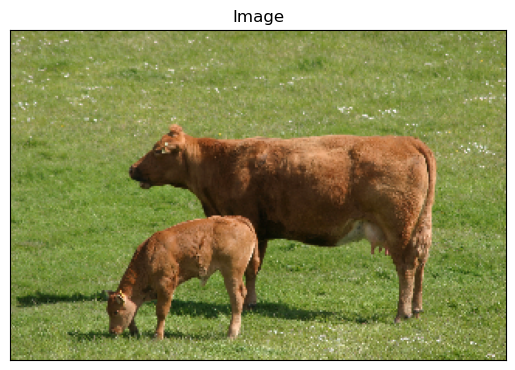

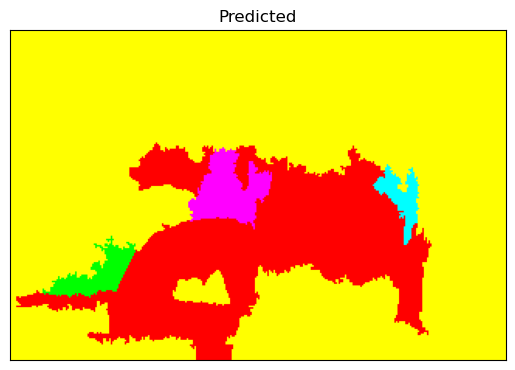

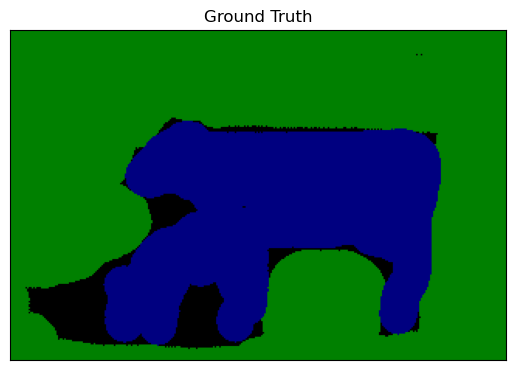

In [172]:
# lets load 1_10_s.bmp from the test set
img_file = '1_9_s.bmp'
gt_file = '1_9_s_GT.bmp'

img_sample = cv2.imread(f'./MSRC_ObjCategImageDatabase_v1/{img_file}')
# img_sample = cv2.cvtColor(img_sample, cv2.COLOR_BGR2RGB)

gt_sample = cv2.imread(f'./MSRC_ObjCategImageDatabase_v1/{gt_file}')
# gt_sample = cv2.cvtColor(gt_sample, cv2.COLOR_BGR2RGB)

segmap = slic(img_sample, n_segments=100, compactness=10)
clusts = np.unique(segmap)

pred_map = {}
predicted_segment = np.zeros(img_sample.shape)
for clust in clusts:
    area = np.argwhere(segmap==clust)
    min_y, max_y = area[:, 0].min() - 3,  area[:, 0].max() + 3
    min_x, max_x = area[:, 1].min() - 3, area[:, 1].max() + 3
    if min_y < 0:
        min_y = 0
    if min_x < 0:
        min_x = 0
    if max_y > img_sample.shape[0]:
        max_y = img_sample.shape[0] - 1
    if max_x > img_sample.shape[1]:
        max_x = img_sample.shape[1]
    img_crop = img_sample[min_y: max_y, min_x: max_x, :]
    img_crop = tr(img_crop).to(device)
    img_crop = img_crop.unsqueeze(0)
    predicted_labels = model(img_crop)
    _,preds = torch.max(predicted_labels, 1)
    pred_map[clust] = preds.item()
    indices = (segmap==clust)
    predicted_segment[indices] = label_2_rgb[preds.item()]
plot_image(img_sample, 'Image')
plot_image(predicted_segment, 'Predicted')
plot_image(gt_sample, 'Ground Truth')

### Question 9: Bonus Question (20 points, OPTIONAL):

IMPORTANT: No matter which option you choose, you can earn a maximum of 20 points for this section.

We always want to increase the classifier accuracy and achieve a better performance by building a complicated deep learning model. There are a lot of tricks which are very popular and work in practice. Try to implement either of following two,

1. Could you effictively fuse different deep features from multiple layers in your network? You are welcome to use the pretrained network. Does your network achieve a better accuracy? There are a lot of exploration in the literature, including ION (Inside-Outside Net) [1], Hypercolumns [2], and PixelNet [3]. The following figure illustrates ION architecture combining features from different layers. Can you do similar thing for our Superpixel classifier?

2. Could you build a Multi-resolution network to explore the effectiveness of the multi-scale on the task of Superpixels segmentation? By multi-scale, we mean multiple resolutions of superpixels. See [4] for an example.

[1] Inside-Outside Net: Detecting Objects in Context with Skip Pooling and Recurrent Neural Networks

[2] Hypercolumns for Object Segmentation and Fine-grained Localization

[3] PixelNet: Representationofthe pixels, by the pixels, and for the pixels

[4] Feedforward semantic segmentation with zoom-out features

In [ ]:
# Bonus
